In [ ]:
# Clone the TensorFlow Models repository
!git clone https://github.com/tensorflow/models.git

# Change the directory to the research folder
%cd models/research

# Compile the protobuf libraries
!protoc object_detection/protos/*.proto --python_out=.

# Install the Object Detection API
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

# Install additional dependencies
!pip install tf_slim
!pip install pycocotools

!pip install symspellpy
!pip install easyocr


Cloning into 'models'...
remote: Enumerating objects: 97415, done.
remote: Counting objects: 100% (695/695), done.
remote: Compressing objects: 100% (325/325), done.
remote: Total 97415 (delta 419), reused 576 (delta 364), pack-reused 96720
Receiving objects: 100% (97415/97415), 613.67 MiB | 28.77 MiB/s, done.
Resolving deltas: 100% (70837/70837), done.
/content/models/research
Processing /content/models/research
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.5/14.5 MB 56.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 68.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.6/49.6 MB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.6/116.6 kB 15.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 5.3 MB/s eta 0:00:00
  Preparing metada

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# This is needed to display the images.
%matplotlib inline

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
import glob

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

# Check if the environment setup is successful
print("Setup successful")


Setup successful


In [ ]:
# Install Tesseract
!apt-get install tesseract-ocr
!pip install pytesseract

# Import necessary libraries
import numpy as np
import os
import tensorflow as tf
import glob
from matplotlib import pyplot as plt
from PIL import Image
import pytesseract
from object_detection.utils import label_map_util, visualization_utils as vis_util
from object_detection.utils import ops as utils_ops

# Ensure matplotlib is inlined for display
%matplotlib inline


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 45 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (8,470 kB/s)
Selecting previously unselected package tesseract-ocr-eng.
(Reading database ... 121913 files and directories currently installed.)
Preparing to unpack .../tesseract-ocr-

In [ ]:
# Install necessary packages

!pip install pillow
!pip install opencv-python-headless
!pip install pytesseract

In [ ]:
!pip install fuzzywuzzy

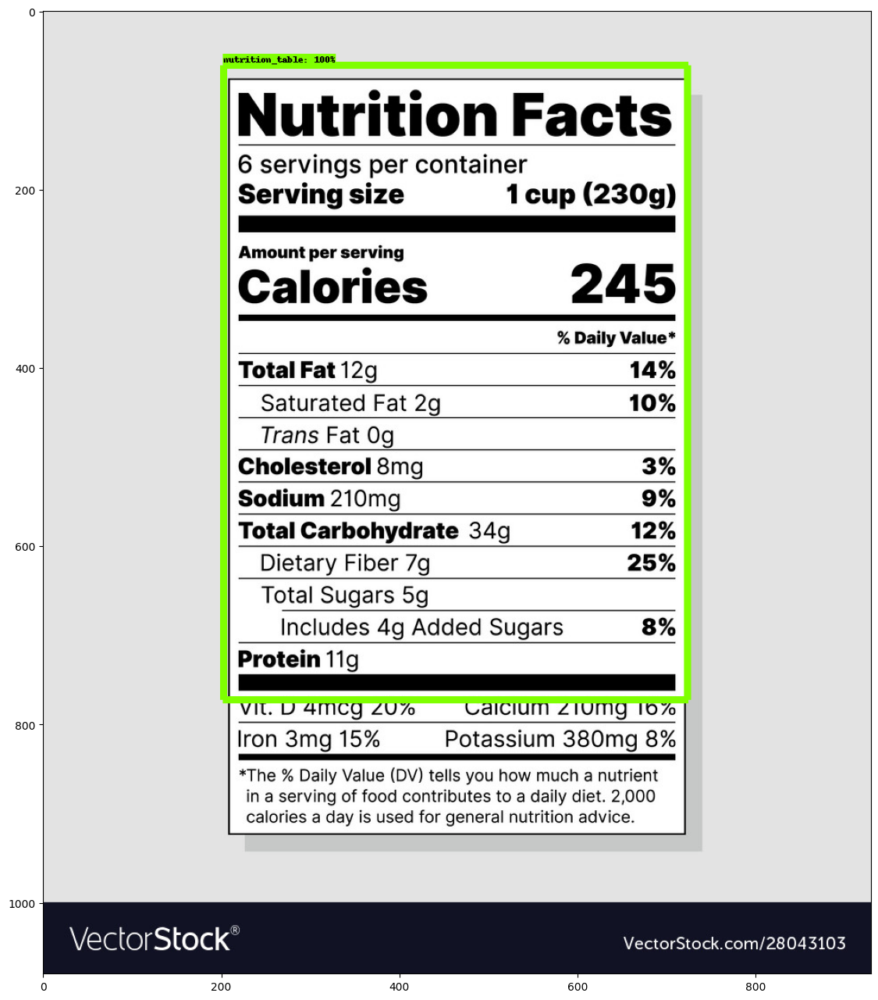

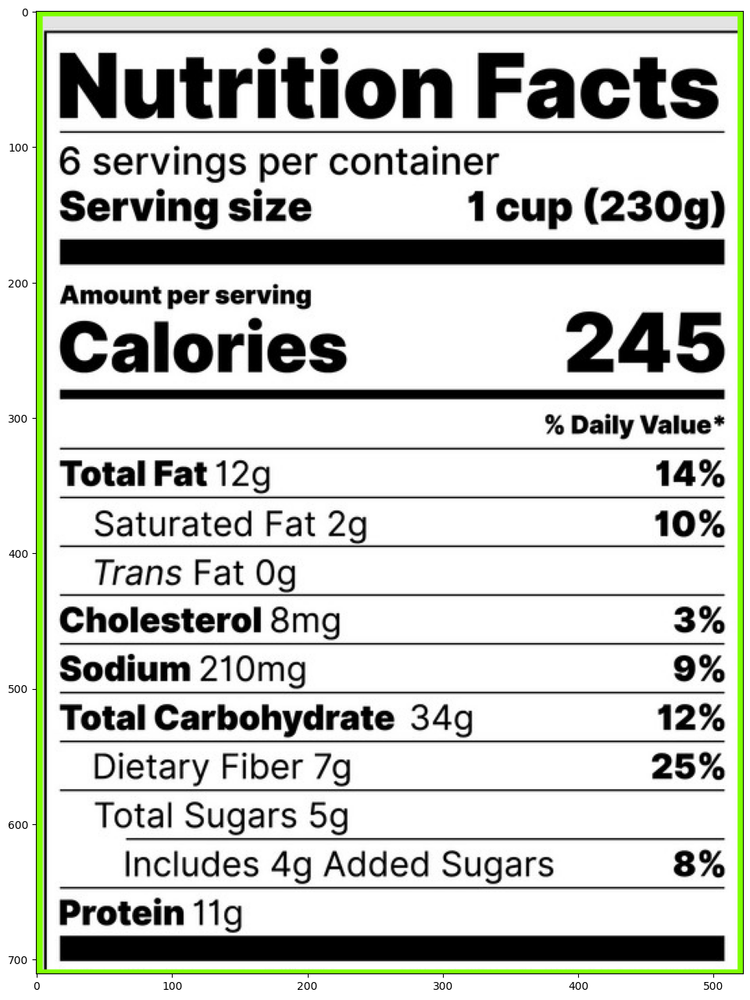

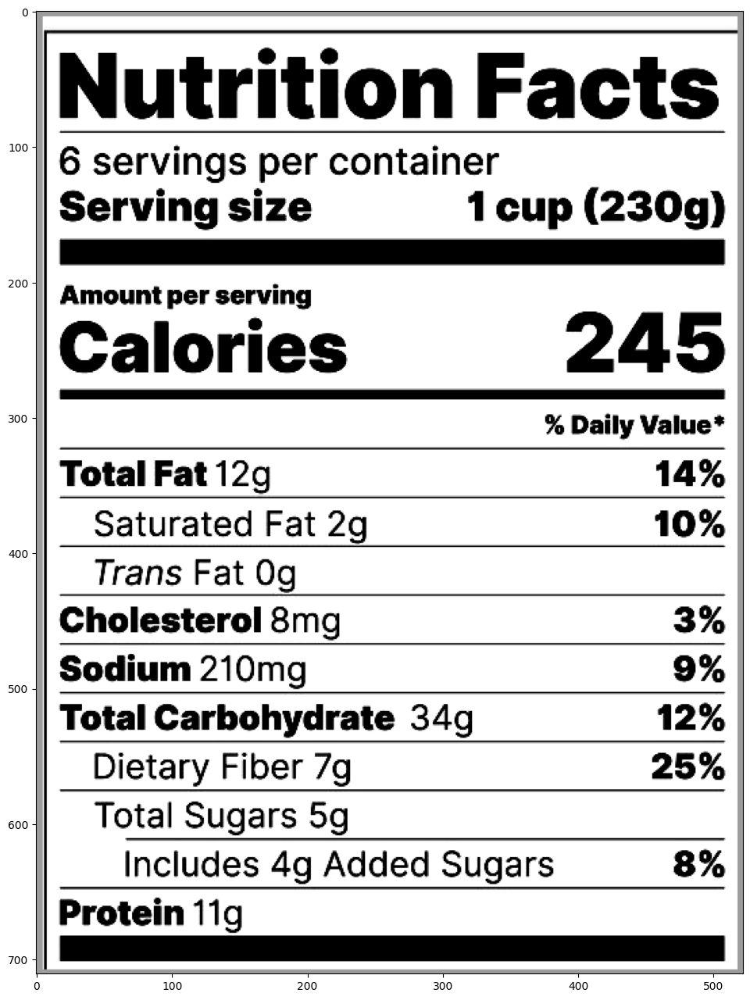

Extracted Text Before Correction:
 

Nutrition Facts

6 servings per container
Serving size 1 cup (230g)
ee

Amount per serving

Calories 245

 

% Daily Value*
Total Fat 129 14%
Saturated Fat 2g 10%
Trans Fat Og
Cholesterol 8mg 3%
Sodium 210mg 9%
Total Carbohydrate 34g 12%
Dietary Fiber 7g 25%
Total Sugars 5g
Includes 4g Added Sugars 8%

Protein 11g

Extracted Text After Regex Correction:
 

Nutrition Facts

6 servings per container
Serving size 1 cup (230g)
ee

Amount per serving

Calories 245

 

% Daily Value*
Total Fat 12g 14%
Saturated Fat 2g 10%
Trans Fat Og
Cholesterol 8mg 3%
Sodium 210mg 9%
Total Carbohydrate 34g 12%
Dietary Fiber 7g 25%
Total Sugars 5g
Includes 4g Added Sugars 8%

Protein 11g

Extracted Nutrition Values:
{'Energy': '245 kkal', 'Fat': '12 g', 'Protein': '11 g', 'Carbohydrate': '34 g', 'Sugar': '5 g'}


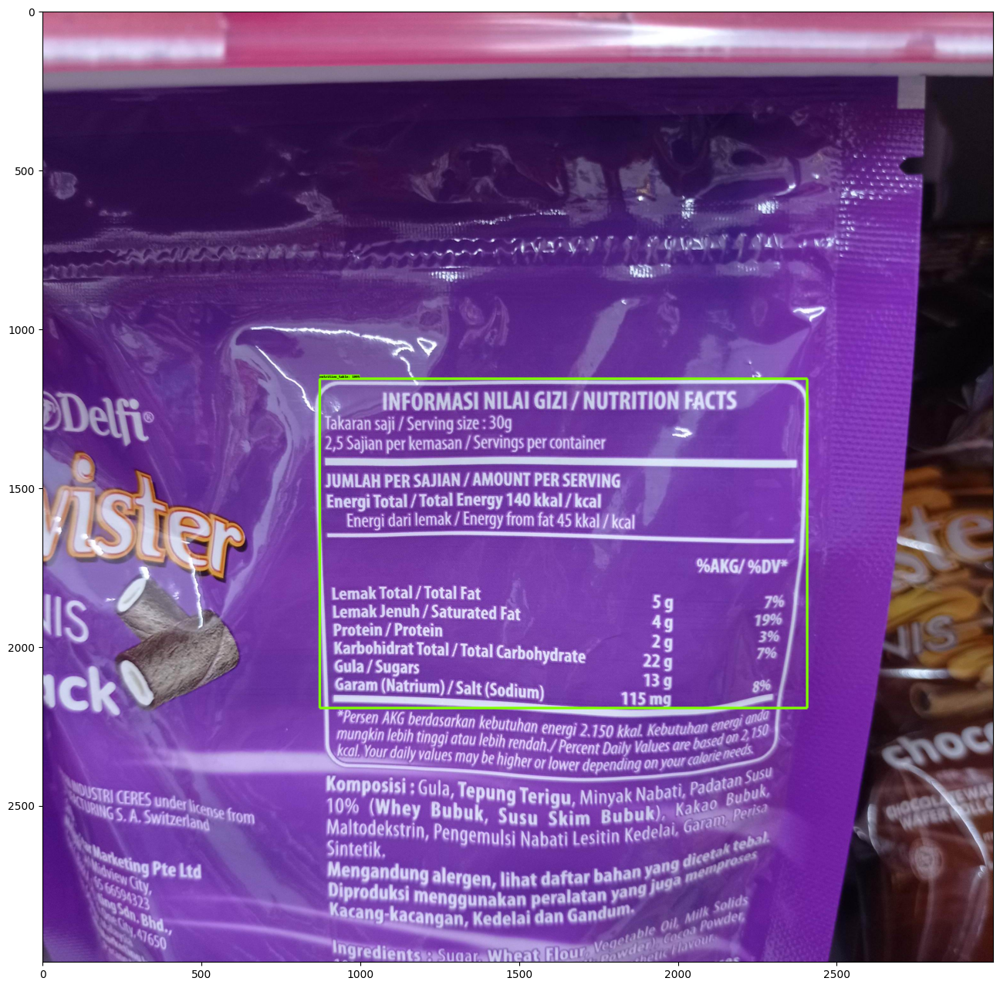

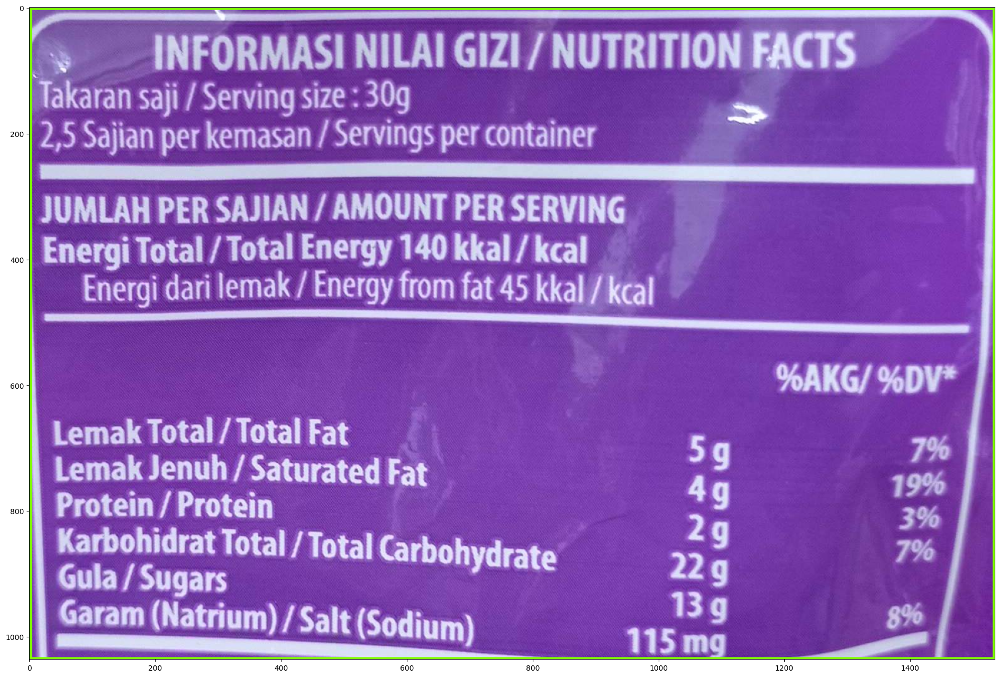

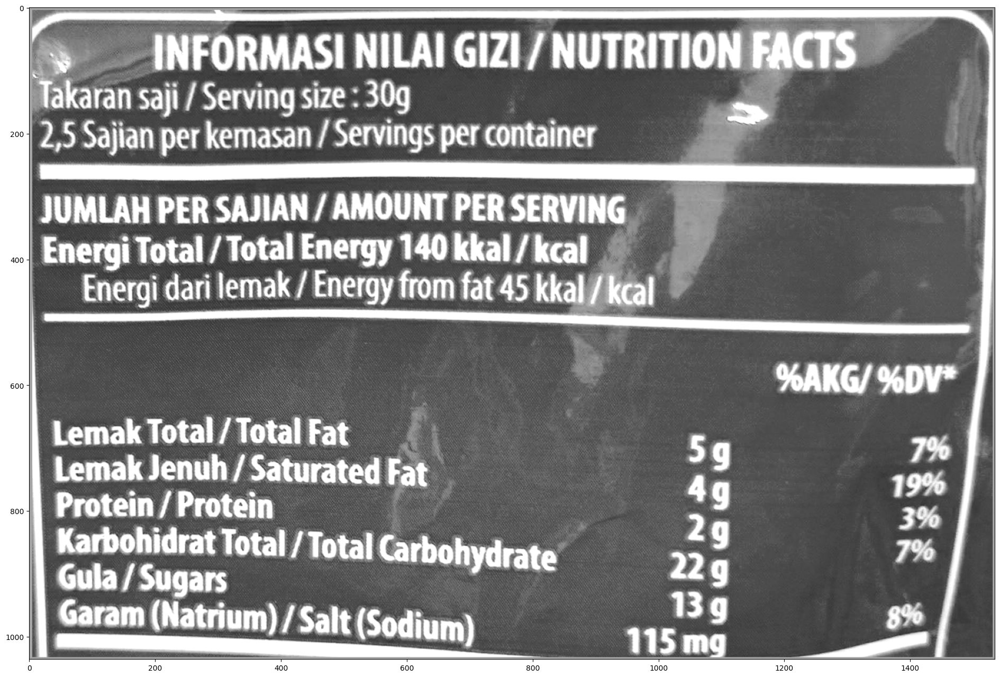

Extracted Text Before Correction:
—

We EEE ar | Mo FACTS
akaran saji / Serving size : 30g >

2,5 Sajian per kemasan / Servings per container F

UE Te PUU e es a) fc
Energi Total / Total Energy 140 kkal / kcal
Energi dari lemak / Energy from fat 45 kkali/ kcal

Lemak Total / Total Fat 5

POE OCU PAS csi h 9 a
ee ST) y -

Karbohidrat Total / Total Ca

nnn Pde

Garam (Natrium) / Salt (Sodium) “a

 

Extracted Text After Regex Correction:
—

We EEE ar | Mo FACTS
akaran saji / Serving size : 30g >

2,5 Sajian per kemasan / Servings per container F

UE Te PUU e es a) fc
Energi Total / Total Energy 140 kkal / kcal
Energi dari lemak / Energy from fat 45 kkali/ kcal

Lemak Total / Total Fat 5

POE OCU PAS csi h 9 a
ee ST) y -

Karbohidrat Total / Total Ca

nnn Pde

Garam (Natrium) / Salt (Sodium) “a

 

Extracted Nutrition Values:
{'Energy': '140 kkal', 'Fat': '5 g', 'Protein': '0 g', 'Carbohydrate': '0 g', 'Sugar': '0 g'}


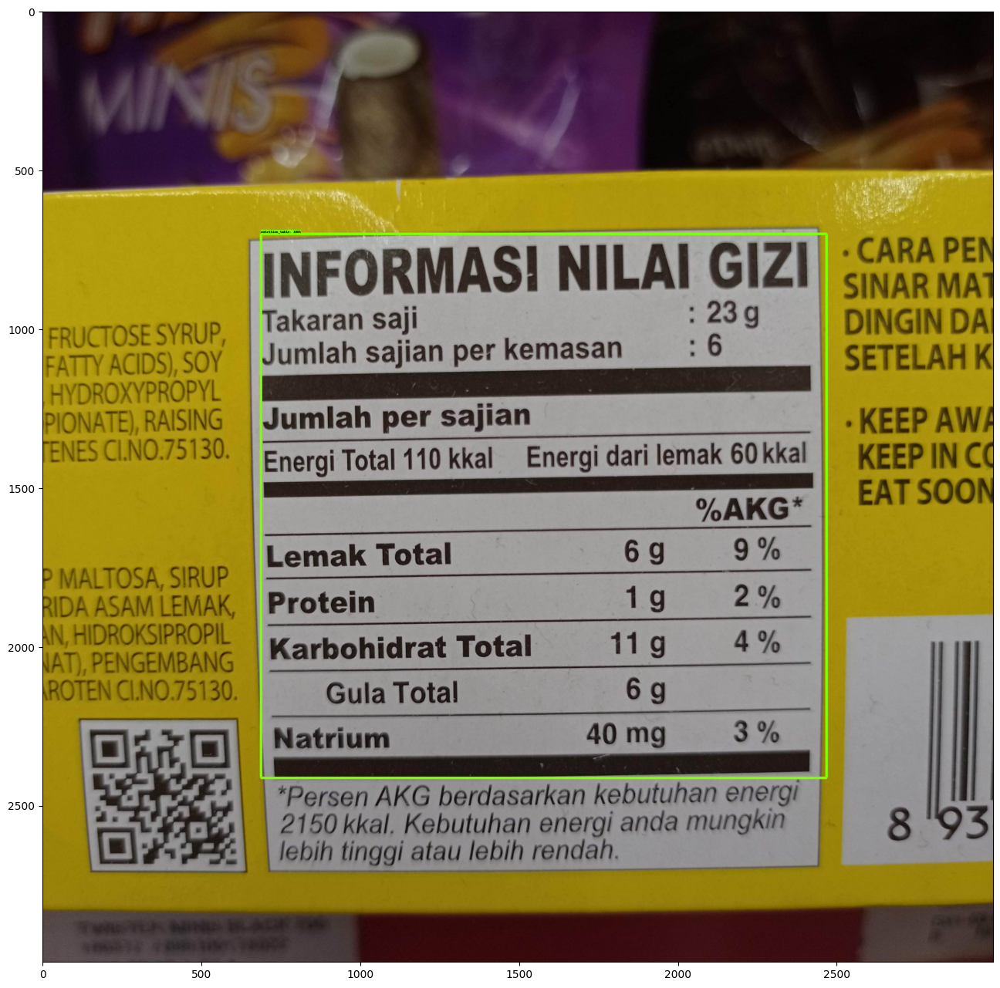

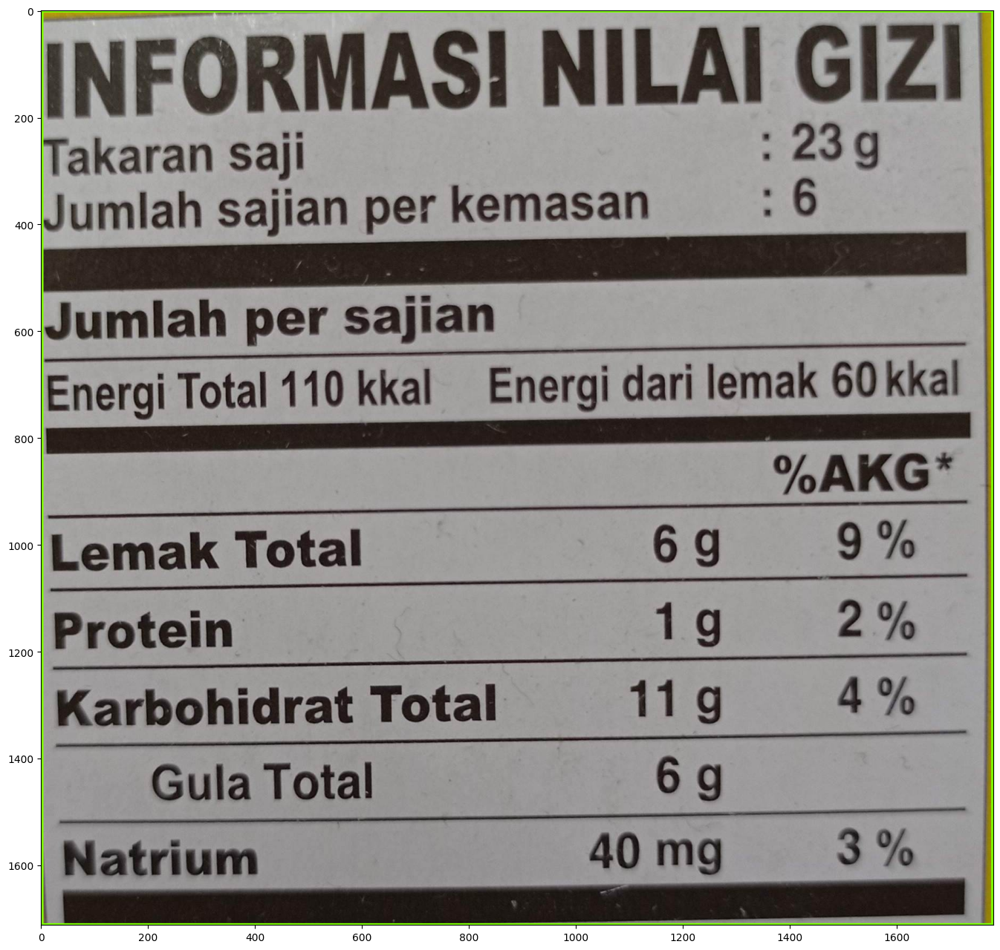

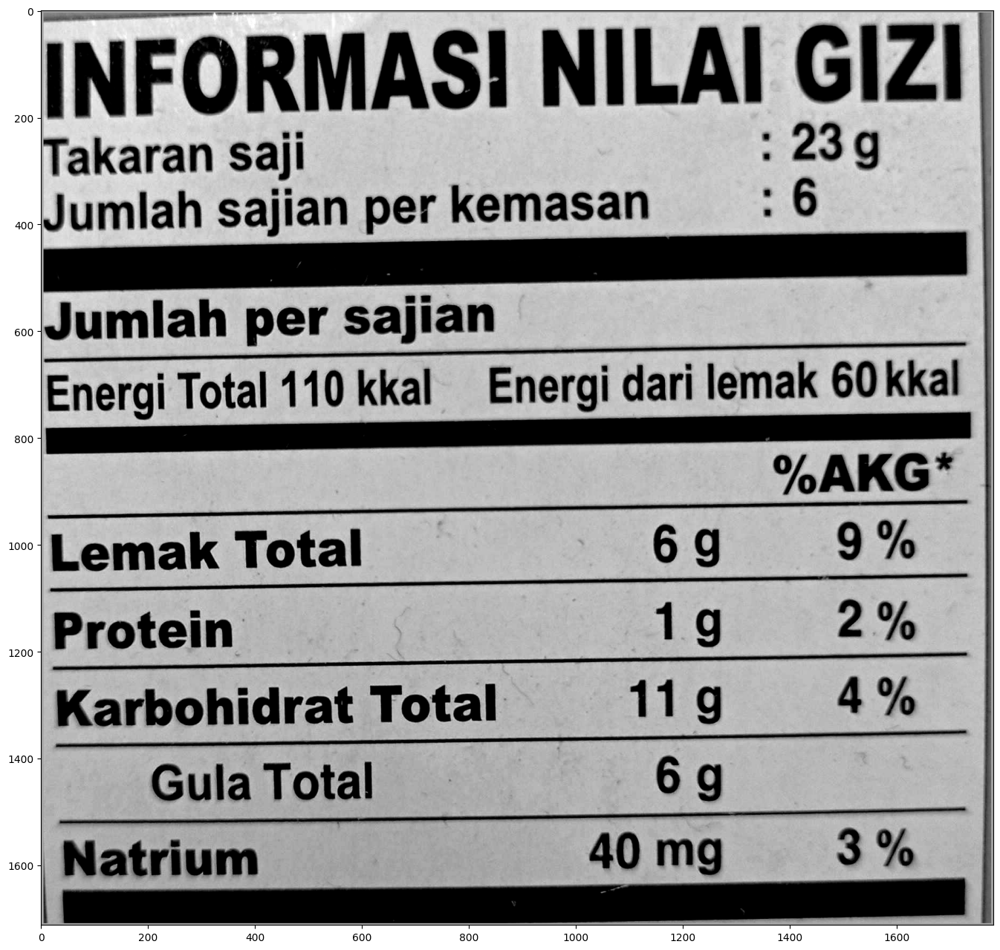

Extracted Text Before Correction:
|

ee ea hd ead steep egret
Energi Total 110 kkal + Energi dari lemak 60 kkal
a

INFORMAS! NILAI Gia

Takaran saji
Jumlah sajian per kemasan ; a

 

Jumlah per sajian

  

%~AKG*
Lemak Total 6g 9%
Protein 1g 2%

Karbohidrat Total 11g 4%
Gula Total 6g

Natrium 40 mg 3%

Ry |

 

Extracted Text After Regex Correction:
|

ee ea hd ead steep egret
Energi Total 110 kkal + Energi dari lemak 60 kkal
a

INFORMAS! NILAI Gia

Takaran saji
Jumlah sajian per kemasan ; a

 

Jumlah per sajian

  

%~AKG*
Lemak Total 6g 9%
Protein 1g 2%

Karbohidrat Total 11g 4%
Gula Total 6g

Natrium 40 mg 3%

Ry |

 

Extracted Nutrition Values:
{'Energy': '110 kkal', 'Fat': '6 g', 'Protein': '1 g', 'Carbohydrate': '11 g', 'Sugar': '6 g'}


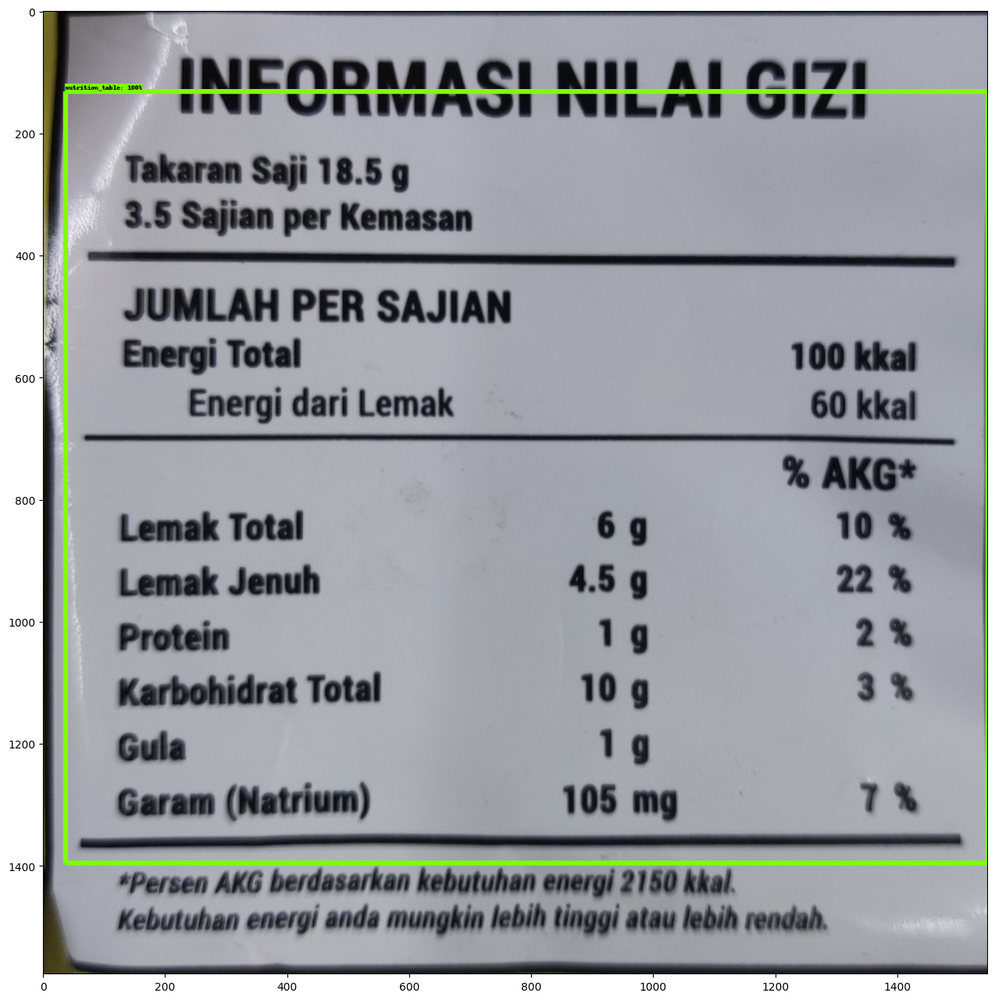

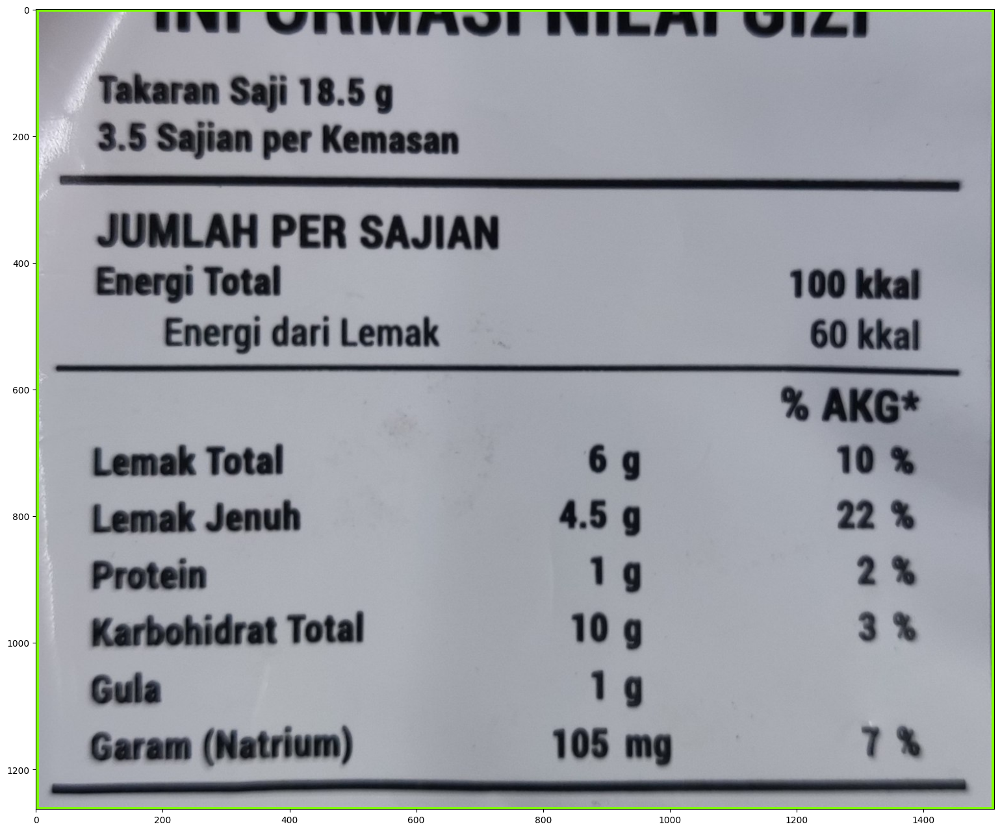

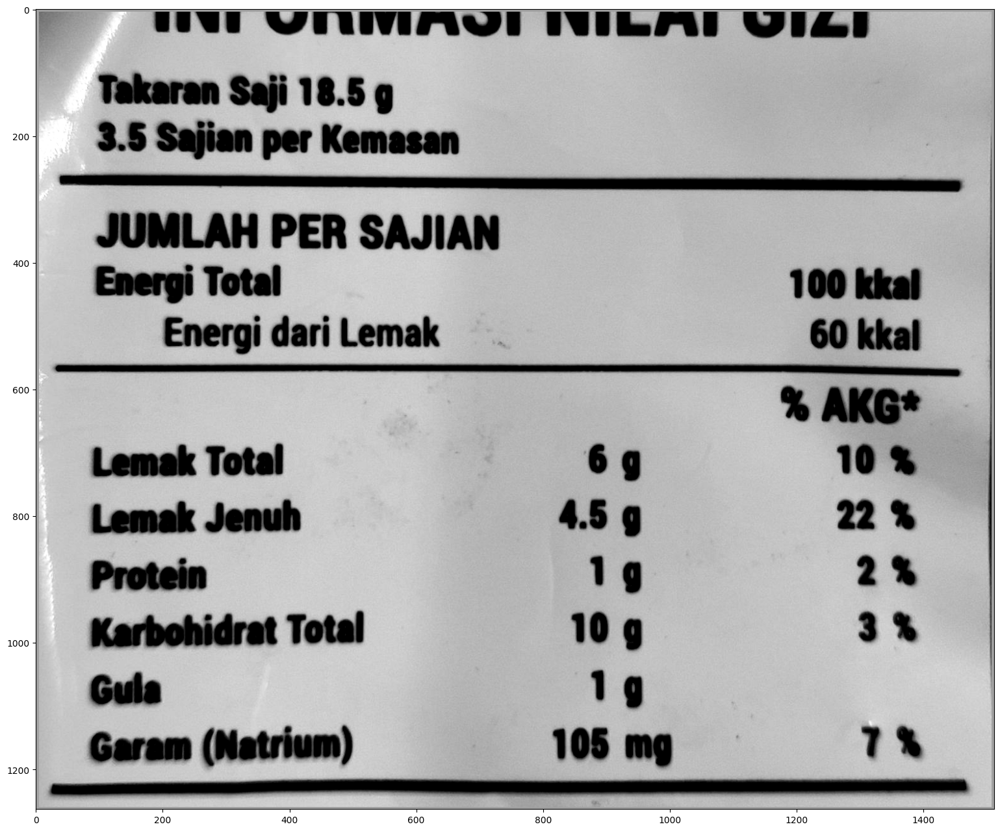

Extracted Text Before Correction:
SOW VITIVIAYI INILAL VICI

 

 

Takaran Saji 18.5 g

3.5 Sajian per Kemasan

JUMLAH PER SAJIAN

Energi Total 100 kkal
Energi dari Lemak 60 kkal

% AKG*

Lemak Total 6g 10%

Lemak Jenuh 4.59 22 %

Protein 19 2%

Karbohidrat Total 109 3%

Gula 1g

Garam (Natrium) 105 mg 7%

 

Extracted Text After Regex Correction:
SOW VITIVIAYI INILAL VICI

 

 

Takaran Saji 18.5 g

3.5 Sajian per Kemasan

JUMLAH PER SAJIAN

Energi Total 100 kkal
Energi dari Lemak 60 kkal

% AKG*

Lemak Total 6g 10%

Lemak Jenuh 4.5g 22 %

Protein 1g 2%

Karbohidrat Total 10g 3%

Gula 1g

Garam (Natrium) 105 mg 7%

 

Extracted Nutrition Values:
{'Energy': '100 kkal', 'Fat': '6 g', 'Protein': '1 g', 'Carbohydrate': '10 g', 'Sugar': '1 g'}


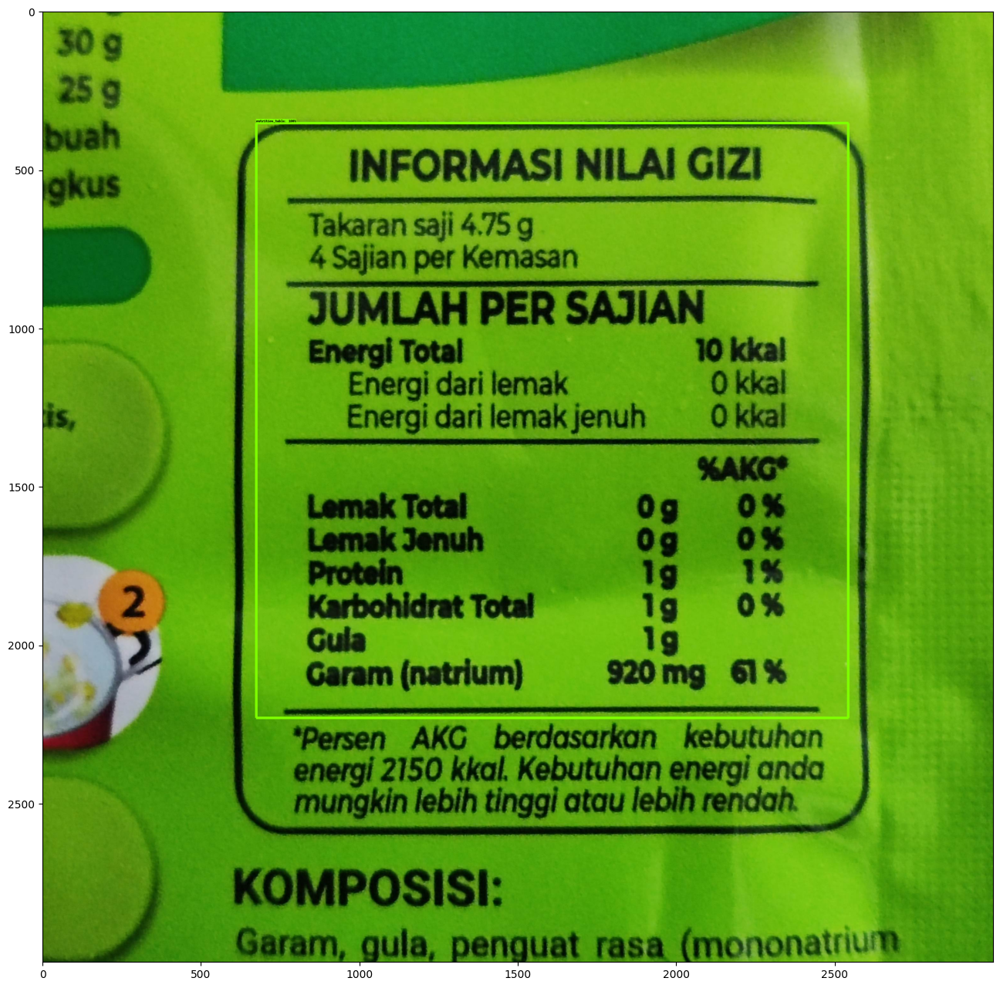

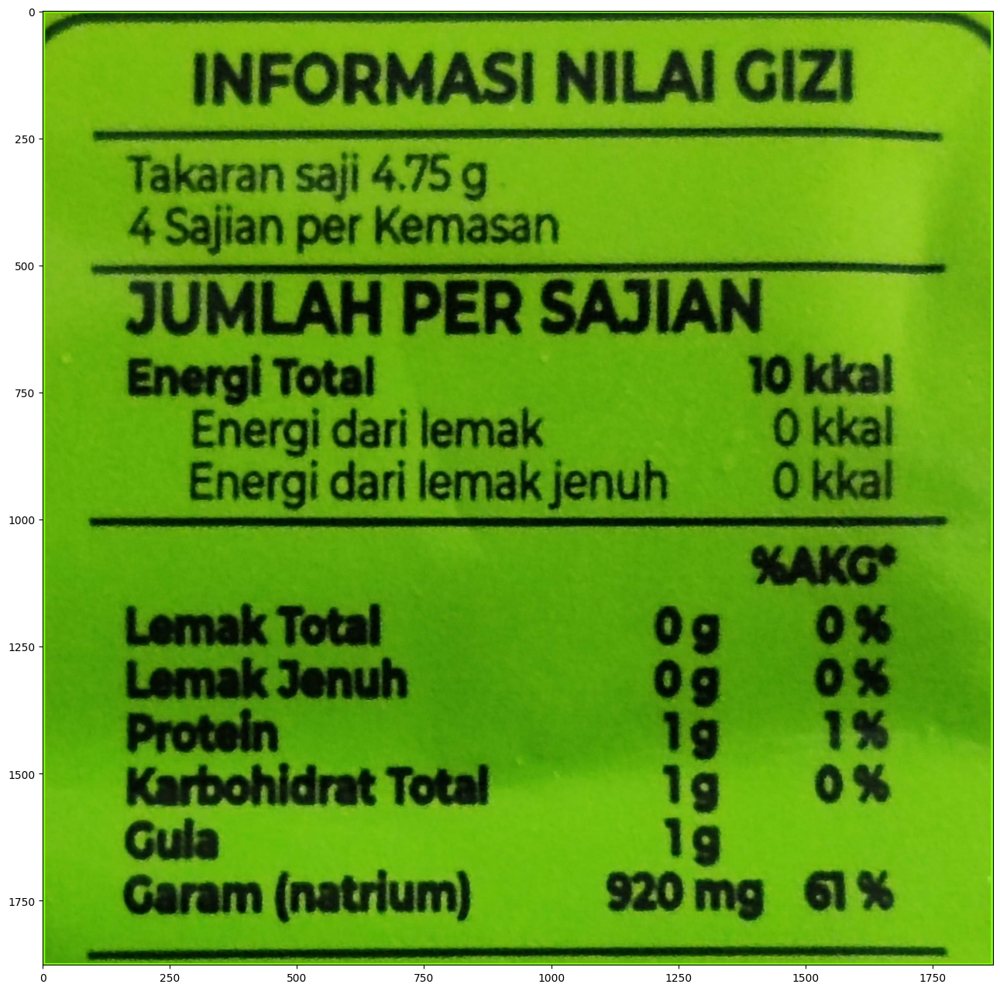

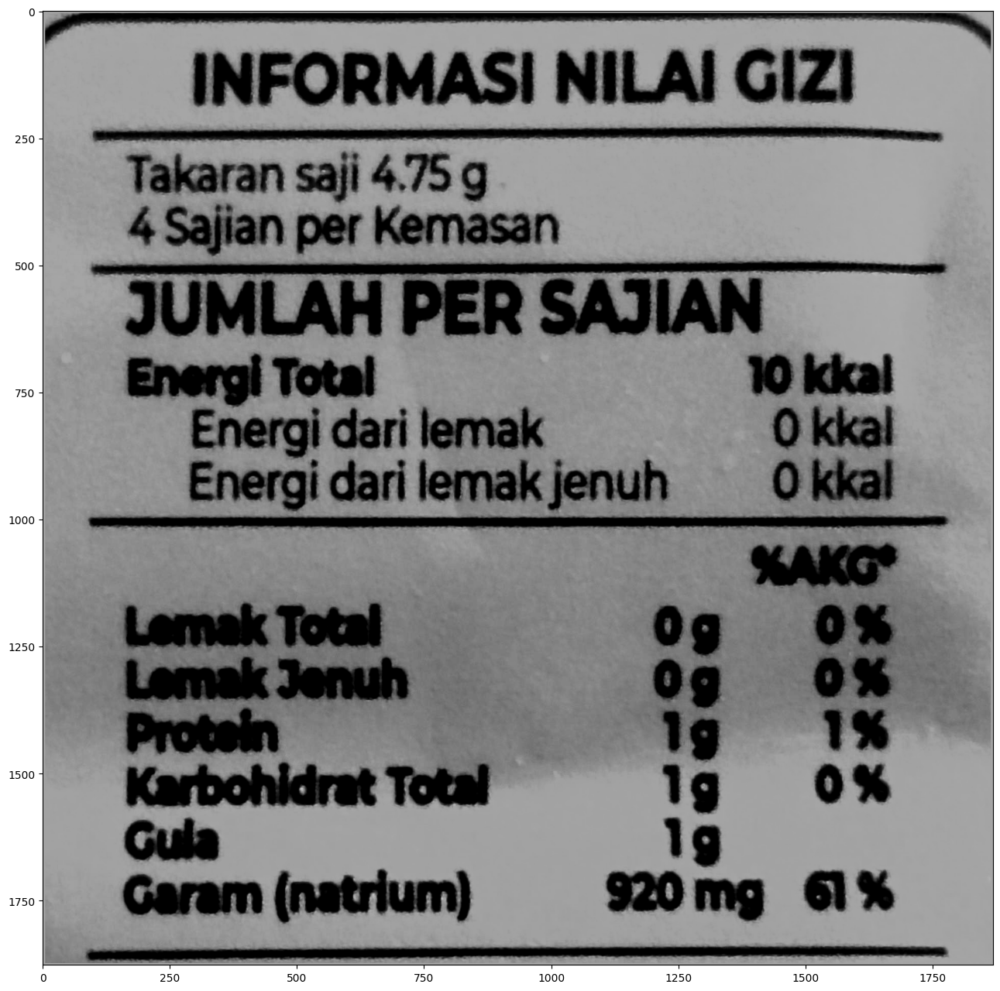

Extracted Text Before Correction:
ee ee ee ee
INFORMASI NILAI GIZI
Takaran saji 4.75 g

 

4 Sajian per Kemasan
JUMLAH PER SAJIAN
Energi Total 10 kkal
Energi dari lemak 0 kkal
Energi dari lemak jenuh 0 kkal
%AKG*
Lemak Total 0g O%
Lemak Jenuh 0g O%
Protein 1g %

 

 

Karbohidrat Total Ig 0%
Gula 1g
Garam (natrium) 920mg 61%

 

 

Extracted Text After Regex Correction:
ee ee ee ee
INFORMASI NILAI GIZI
Takaran saji 4.75 g

 

4 Sajian per Kemasan
JUMLAH PER SAJIAN
Energi Total 10 kkal
Energi dari lemak 0 kkal
Energi dari lemak jenuh 0 kkal
%AKG*
Lemak Total 0g O%
Lemak Jenuh 0g O%
Protein 1g %

 

 

Karbohidrat Total Ig 0%
Gula 1g
Garam (natrium) 920mg 61%

 

 

Extracted Nutrition Values:
{'Energy': '10 kkal', 'Fat': '0 g', 'Protein': '1 g', 'Carbohydrate': '0 g', 'Sugar': '1 g'}


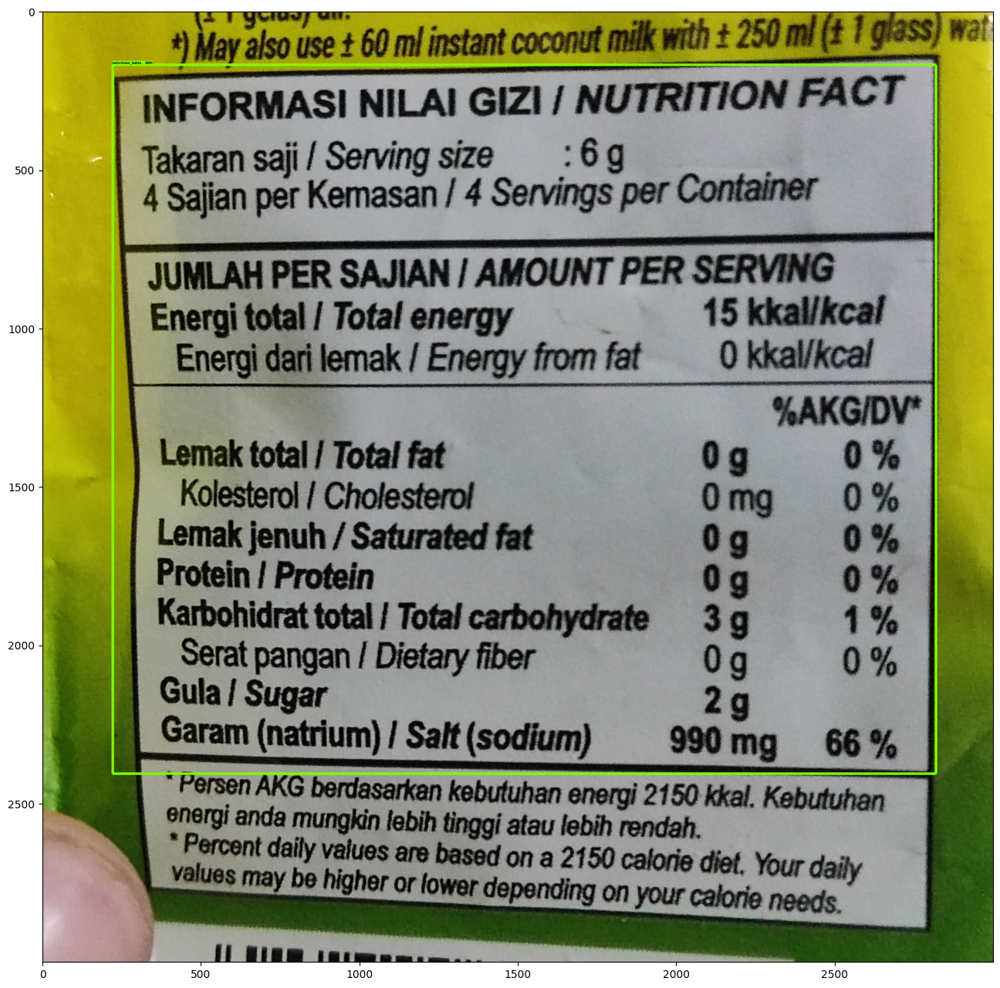

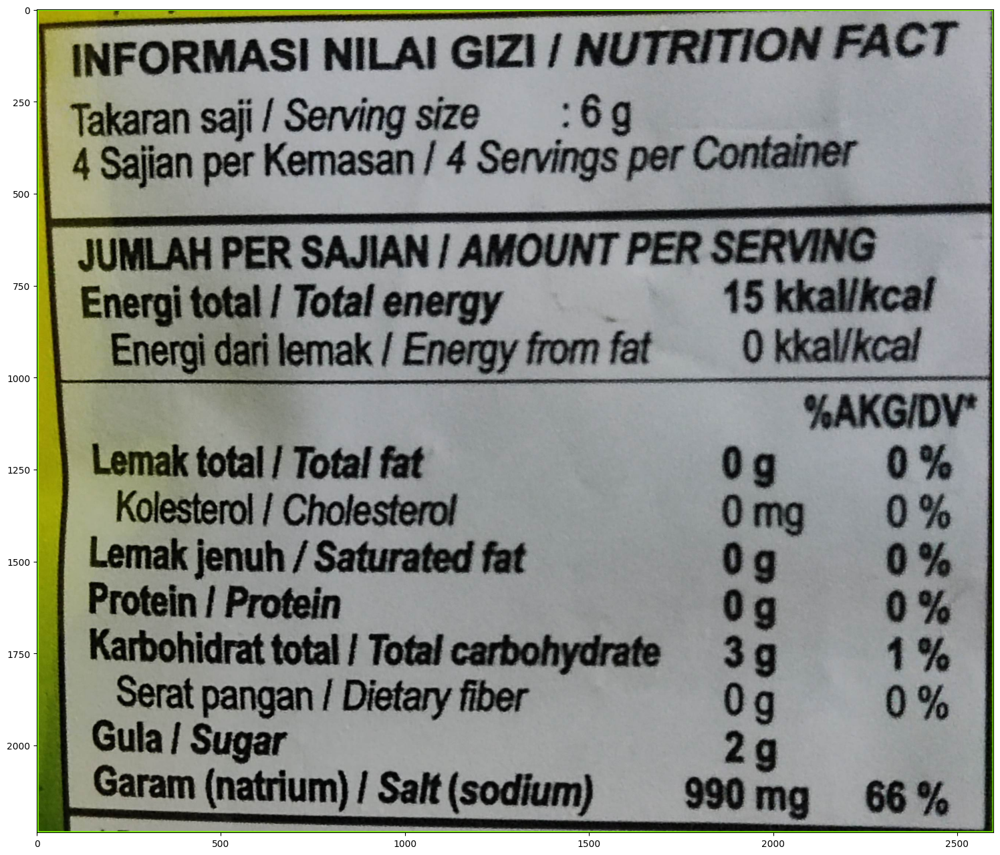

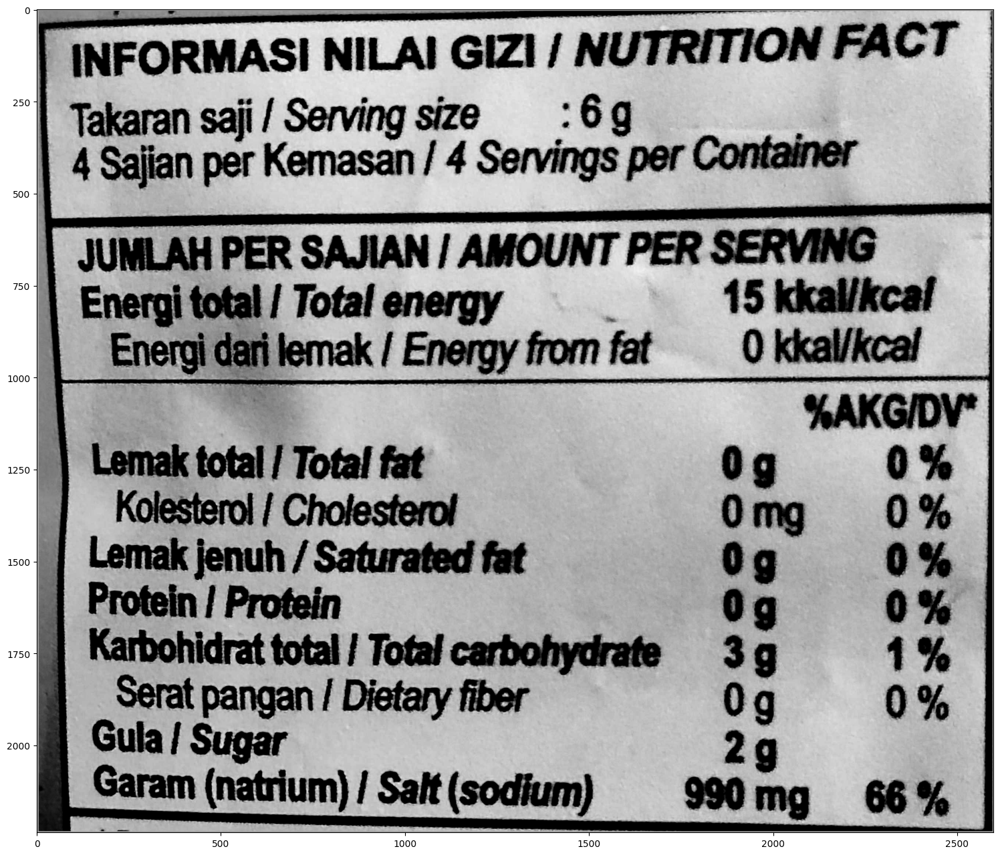

Extracted Text Before Correction:
 

INFORMASI NILA! GIZI / NUTRITION FACT —
Takaran saji/Servingsize :6qg
4 Sajian per Kemasan / 4 Servings per Container

JUMLAH PER SAJIAN | AMOUNT PER SERVING
Energi total / Total energy 3 15 kkal/kcal
Energi dari lemak / Energy from fat _ Kkal/kcal

  
  
    
    
   
   
   
   
     
   

  

  

Lemak total / Tota! fat 0g 0%
Kolesterol / Cholesterol Omg 0%
Lemak jenuh / Saturated fat Og 0%

j Karbohidrat total / Total carbohydrate 3g 1%
Serat pangan / Dietary fiber Og 0%

Gula / Sugar 29g
Garam (natrium) / Sait (sodium)

Extracted Text After Regex Correction:
 

INFORMASI NILA! GIZI / NUTRITION FACT —
Takaran saji/Servingsize :6qg
4 Sajian per Kemasan / 4 Servings per Container

JUMLAH PER SAJIAN | AMOUNT PER SERVING
Energi total / Total energy 3 15 kkal/kcal
Energi dari lemak / Energy from fat _ Kkal/kcal

  
  
    
    
   
   
   
   
     
   

  

  

Lemak total / Tota! fat 0g 0%
Kolesterol / Cholesterol Omg 0%
Lemak jenuh / Saturated fa

In [ ]:
import os
import numpy as np
import tensorflow as tf
from PIL import Image, ImageEnhance
import matplotlib.pyplot as plt
import cv2
import pytesseract
import glob
import re

# Define paths
PATH_TO_CKPT = '/content/drive/MyDrive/data/frozen_inference_graph.pb'
PATH_TO_LABELS = '/content/drive/MyDrive/data/nutrition.pbtxt'
NUM_CLASSES = 1

# Load the frozen TensorFlow model into memory
detection_graph = tf.compat.v1.Graph()
with detection_graph.as_default():
    od_graph_def = tf.compat.v1.GraphDef()
    with tf.io.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.compat.v1.Session() as sess:
            ops = tf.compat.v1.get_default_graph().get_operations()
            all_tensor_names = {output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in ['num_detections', 'detection_boxes', 'detection_scores', 'detection_classes']:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.compat.v1.get_default_graph().get_tensor_by_name(tensor_name)
            image_tensor = tf.compat.v1.get_default_graph().get_tensor_by_name('image_tensor:0')
            output_dict = sess.run(tensor_dict, feed_dict={image_tensor: np.expand_dims(image, 0)})
            output_dict['num_detections'] = int(output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict['detection_classes'][0].astype(np.int64)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
    return output_dict

def crop_detected_table(image_np, boxes, scores, min_score_thresh=0.5):
    im_height, im_width, _ = image_np.shape
    for i in range(boxes.shape[0]):
        if scores[i] > min_score_thresh:
            box = tuple(boxes[i].tolist())
            ymin, xmin, ymax, xmax = box
            (left, right, top, bottom) = (xmin * im_width, xmax * im_width, ymin * im_height, ymax * im_height)
            cropped_image = image_np[int(top):int(bottom), int(left):int(right)]
            return cropped_image
    return None

def preprocess_for_ocr(img, enhance=1):
    if enhance > 1:
        img = Image.fromarray(img)
        contrast = ImageEnhance.Contrast(img)
        img = contrast.enhance(enhance)
        img = np.asarray(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    return img

def ocr(img, oem=1, psm=3):
    config = ('-l eng --oem {oem} --psm {psm}'.format(oem=oem,psm=psm))
    try:
        img = Image.fromarray(img)
        text = pytesseract.image_to_string(img, config=config)
        return text
    except:
        return ""

def correct_ocr_errors(text):
    # Define a regex pattern to identify common errors where '9' should be 'g'
    pattern = r'(\d)9\b'  # Look for a digit followed by '9' at the end of a word
    corrected_text = re.sub(pattern, r'\1g', text)  # Replace '9' with 'g'
    return corrected_text

def extract_nutrition_values(text, key_terms):
    nutritional_info = {key: None for key in key_terms.keys()}
    for key, terms in key_terms.items():
        for term in terms:
            pattern = re.compile(rf'{term}\s+(\d+)', re.IGNORECASE)
            match = re.search(pattern, text)
            if match:
                value = match.group(1)
                if key == 'Energy':
                    nutritional_info[key] = f"{value} kkal"
                else:
                    nutritional_info[key] = f"{value} g"
                break
        if nutritional_info[key] is None:
            if key == 'Energy':
                nutritional_info[key] = "0 kkal"
            else:
                nutritional_info[key] = "0 g"
    return nutritional_info

# Define the folder containing test images
test_images_folder = '/content/drive/MyDrive/data/test_images'

# Get the list of all image files in the folder
image_files = glob.glob(os.path.join(test_images_folder, '*.jpg'))

# Define key terms for nutrition extraction
key_terms = {
    'Energy': ['energi total', 'total energy', 'calories', ],
    'Fat': ['lemak total', 'total fat'],
    'Protein': ['protein'],
    'Carbohydrate': ['karbohidrat total', 'total carbohydrate'],
    'Sugar': ['gula total', 'total sugars', 'gula', 'sugar']
}

# Process each image file
for image_path in image_files:
    try:
        image = Image.open(image_path)
        image_np = load_image_into_numpy_array(image)
        output_dict = run_inference_for_single_image(image_np, detection_graph)

        vis_util.visualize_boxes_and_labels_on_image_array(
            image_np,
            output_dict['detection_boxes'],
            output_dict['detection_classes'],
            output_dict['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            line_thickness=8)

        plt.figure(figsize=(24, 16))
        plt.imshow(image_np)
        plt.show()

        cropped_image = crop_detected_table(image_np, output_dict['detection_boxes'], output_dict['detection_scores'])
        if cropped_image is not None:
            plt.figure(figsize=(24, 16))
            plt.imshow(cropped_image)
            plt.show()

            # OCR processing
            preprocessed_image = preprocess_for_ocr(cropped_image, enhance=2)
            plt.figure(figsize=(24, 16))
            plt.imshow(preprocessed_image)
            plt.show()

            extracted_text = ocr(preprocessed_image)
            print("Extracted Text Before Correction:")
            print(extracted_text)

            # Correct OCR errors using regex
            corrected_text = correct_ocr_errors(extracted_text)
            print("Extracted Text After Regex Correction:")
            print(corrected_text)

            # Extract nutrition values
            nutrition_values = extract_nutrition_values(corrected_text, key_terms)
            print("Extracted Nutrition Values:")
            print(nutrition_values)

            # Save OCR result and extracted values to text file
            text_output_path = image_path.replace('.jpg', '.txt')
            with open(text_output_path, 'w') as text_file:
                text_file.write(corrected_text + '\n\n' + str(nutrition_values))
    except Exception as e:
        print(f"Error processing {image_path}: {e}")


In [ ]:
import tensorflow as tf

# Print TensorFlow version
print("Pytesseract version:", pytesseract.__version__)

# Check TensorFlow Lite version
try:
    import tensorflow.lite as tflite
    print("TensorFlow Lite version:", tflite.__version__)
except AttributeError:
    print("TensorFlow Lite version is the same as TensorFlow version:", tf.__version__)


Pytesseract version: 0.3.10
TensorFlow Lite version is the same as TensorFlow version: 2.16.1


In [ ]:
import tensorflow as tf

# Path to the frozen graph and output TFLite model
PATH_TO_CKPT = '/content/drive/MyDrive/data/frozen_inference_graph.pb'
PATH_TO_TFLITE = '/content/drive/MyDrive/data/images/cropped_images/model.tflite'

# Input and output arrays (use names found in the frozen graph)
input_arrays = ['image_tensor']
output_arrays = ['detection_boxes', 'detection_scores', 'detection_classes', 'num_detections']

# Load the frozen graph and convert it
converter = tf.compat.v1.lite.TFLiteConverter.from_frozen_graph(
    PATH_TO_CKPT, input_arrays, output_arrays, input_shapes={'image_tensor': [1, None, None, 3]})

# Enable TensorFlow Select Ops
converter.target_spec.supported_ops = [
    tf.lite.OpsSet.TFLITE_BUILTINS,
    tf.lite.OpsSet.SELECT_TF_OPS
]

# Allow custom operations
converter.allow_custom_ops = True

# Convert the model
tflite_model = converter.convert()

# Save the model
with open(PATH_TO_TFLITE, 'wb') as f:
    f.write(tflite_model)


In [ ]:
import tensorflow as tf

# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path='/content/drive/MyDrive/data/images/model.tflite')

# Get input details
input_details = interpreter.get_input_details()
print(input_details)


[{'name': 'image_tensor', 'index': 0, 'shape': array([1, 1, 1, 3], dtype=int32), 'shape_signature': array([-1, -1, -1,  3], dtype=int32), 'dtype': <class 'numpy.uint8'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]


In [ ]:
import tensorflow as tf

# Load the TFLite model
model_path = '/content/drive/MyDrive/data/images/model.tflite'
interpreter = tf.lite.Interpreter(model_path=model_path)

# Allocate tensors
interpreter.allocate_tensors()

# Get input and output tensor details
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

print("Input details:", input_details)
print("Output details:", output_details)


Input details: [{'name': 'image_tensor', 'index': 0, 'shape': array([1, 1, 1, 3], dtype=int32), 'shape_signature': array([-1, -1, -1,  3], dtype=int32), 'dtype': <class 'numpy.uint8'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]
Output details: [{'name': 'detection_boxes', 'index': 343, 'shape': array([  1, 100,   4], dtype=int32), 'shape_signature': array([ -1, 100,   4], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}, {'name': 'detection_scores', 'index': 346, 'shape': array([  1, 100], dtype=int32), 'shape_signature': array([ -1, 100], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=flo

In [ ]:
import tensorflow as tf

PATH_TO_CKPT = '/content/drive/MyDrive/data/frozen_inference_graph.pb'

def load_frozen_model(pb_file_path):
    detection_graph = tf.Graph()
    with detection_graph.as_default():
        od_graph_def = tf.compat.v1.GraphDef()
        with tf.io.gfile.GFile(pb_file_path, 'rb') as fid:
            serialized_graph = fid.read()
            od_graph_def.ParseFromString(serialized_graph)
            tf.import_graph_def(od_graph_def, name='')
    return detection_graph

detection_graph = load_frozen_model(PATH_TO_CKPT)


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import load_model

def convert_to_saved_model(frozen_graph, export_dir):
    with tf.compat.v1.Session(graph=frozen_graph) as sess:
        builder = tf.compat.v1.saved_model.builder.SavedModelBuilder(export_dir)

        inputs = {'image_tensor': frozen_graph.get_tensor_by_name('image_tensor:0')}
        outputs = {
            'detection_boxes': frozen_graph.get_tensor_by_name('detection_boxes:0'),
            'detection_scores': frozen_graph.get_tensor_by_name('detection_scores:0'),
            'detection_classes': frozen_graph.get_tensor_by_name('detection_classes:0'),
            'num_detections': frozen_graph.get_tensor_by_name('num_detections:0'),
        }

        signature = tf.compat.v1.saved_model.signature_def_utils.predict_signature_def(inputs, outputs)
        builder.add_meta_graph_and_variables(
            sess, [tf.saved_model.SERVING],
            signature_def_map={'serving_default': signature}
        )

        builder.save()

export_dir = '/content/drive/MyDrive/data/save_model'
convert_to_saved_model(detection_graph, export_dir)


Instructions for updating:
This API was designed for TensorFlow v1. See https://www.tensorflow.org/guide/migrate for instructions on how to migrate your code to TensorFlow v2.


In [ ]:
import tensorflow as tf
from tensorflow import keras

def convert_saved_model_to_keras(saved_model_dir, keras_model_path):
    model = tf.saved_model.load(saved_model_dir)
    # Get the serving_default signature
    infer = model.signatures['serving_default']

    # Create input layer based on the input signature of the serving_default function
    input_layer = tf.keras.layers.InputLayer(input_shape=infer.structured_input_signature[1]['image_tensor'].shape[1:])

    # Pass the input tensor as a dictionary to the infer function
    outputs = {
        'detection_boxes': tf.keras.layers.Lambda(lambda x: infer(x={'image_tensor': x})['detection_boxes'])(input_layer),
        'detection_scores': tf.keras.layers.Lambda(lambda x: infer(x={'image_tensor': x})['detection_scores'])(input_layer),
        'detection_classes': tf.keras.layers.Lambda(lambda x: infer(x={'image_tensor': x})['detection_classes'])(input_layer),
        'num_detections': tf.keras.layers.Lambda(lambda x: infer(x={'image_tensor': x})['num_detections'])(input_layer)
    }

    # Build the Keras model using the Functional API
    keras_model = tf.keras.Model(inputs=input_layer, outputs=outputs)
    keras_model.save(keras_model_path)

keras_model_path = '/content/drive/MyDrive/data/save_model/model.h5'
convert_saved_model_to_keras(export_dir, keras_model_path)

TypeError: Exception encountered when calling layer 'lambda_6' (type Lambda).

Binding inputs to tf.function failed due to `got an unexpected keyword argument 'x'`. Received args: () and kwargs: {'x': {'image_tensor': <keras.src.engine.input_layer.InputLayer object at 0x79d9c4675cf0>}} for signature: () -> Dict[['detection_boxes', TensorSpec(shape=<unknown>, dtype=tf.float32, name=None)], ['num_detections', TensorSpec(shape=<unknown>, dtype=tf.float32, name=None)], ['detection_scores', TensorSpec(shape=<unknown>, dtype=tf.float32, name=None)], ['detection_classes', TensorSpec(shape=<unknown>, dtype=tf.float32, name=None)]].
Fallback to flat signature also failed due to: pruned(image_tensor) missing required arguments: image_tensor.

Call arguments received by layer 'lambda_6' (type Lambda):
  • inputs=<keras.src.engine.input_layer.InputLayer object at 0x79d9c4675cf0>
  • mask=None
  • training=None